In [1]:
import numpy as np
import pandas as pd
import seaborn as sns


In [2]:
data = pd.read_csv("train.csv")
data.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1


C:\Users\anike\AppData\Local\Temp\ipykernel_3988\3127572689.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data['px_height'])


<AxesSubplot: xlabel='px_height', ylabel='Density'>

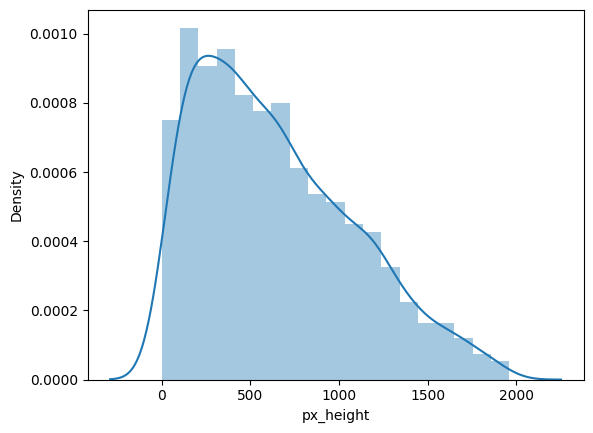

In [3]:
sns.distplot(data['px_height'])

C:\Users\anike\AppData\Local\Temp\ipykernel_3988\2585957323.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data['px_width'])


<AxesSubplot: xlabel='px_width', ylabel='Density'>

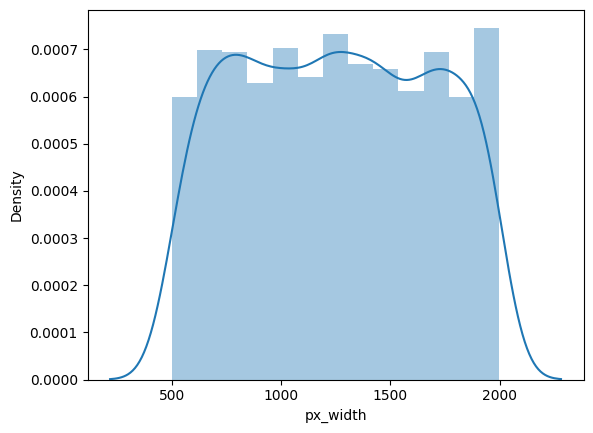

In [4]:
sns.distplot(data['px_width'])

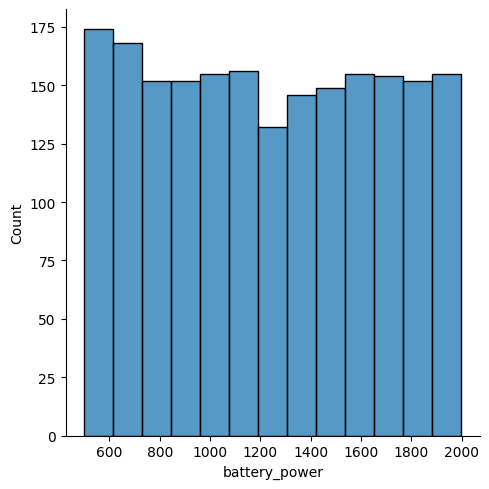

In [5]:
sns.displot(data['battery_power'])

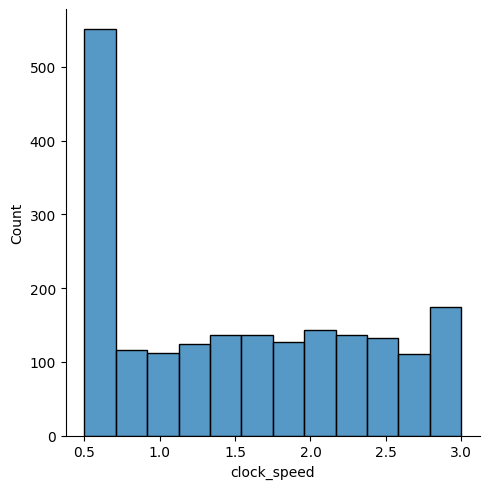

In [6]:
sns.displot(data['clock_speed'])

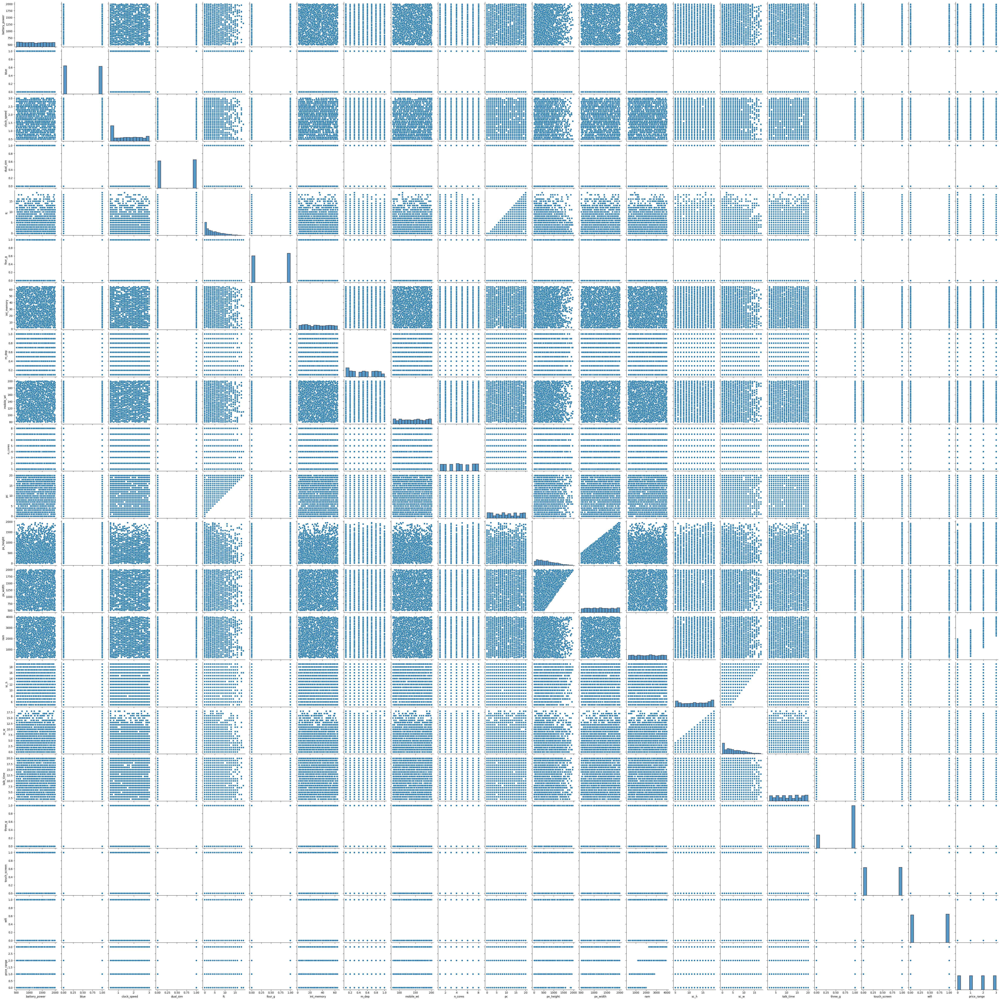

In [7]:
sns.pairplot(data)

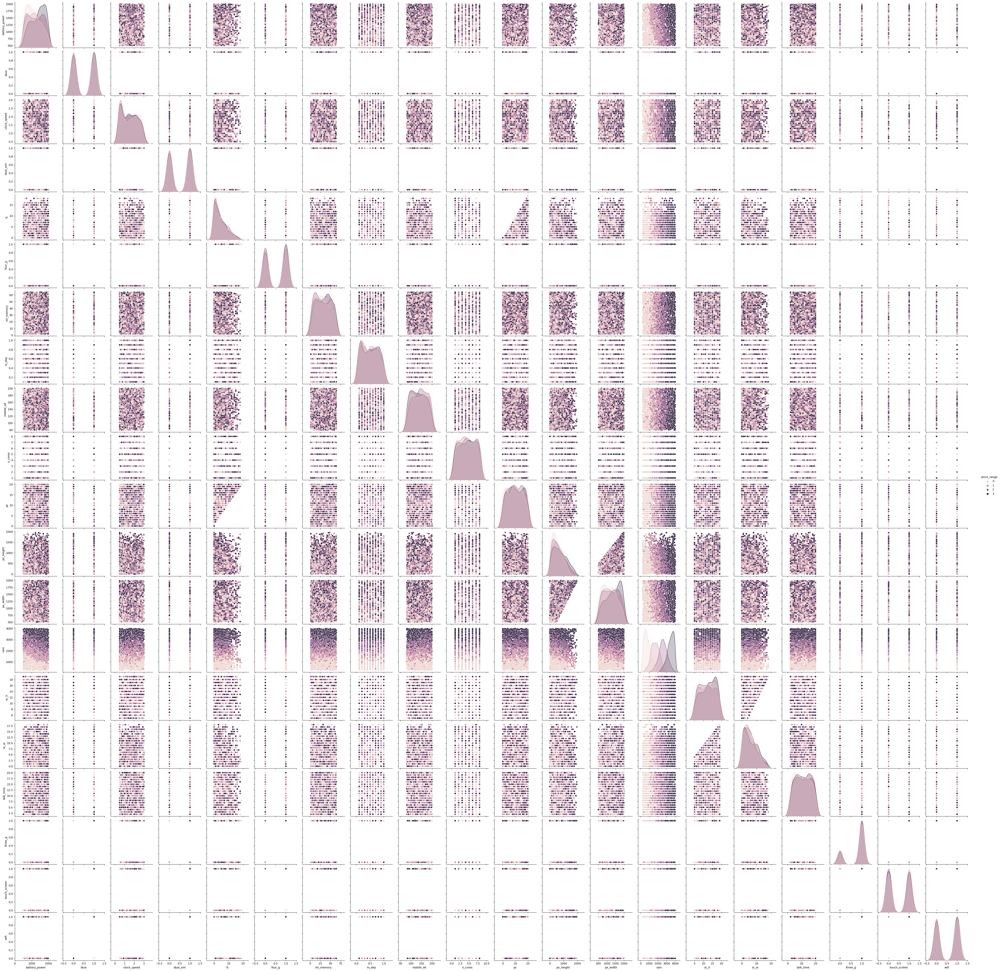

In [9]:
sns.pairplot(data,hue="price_range")

In [8]:
import matplotlib.pyplot as plt

In [27]:
x = data.drop(['price_range'],axis="columns")
y = data.price_range
x.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0


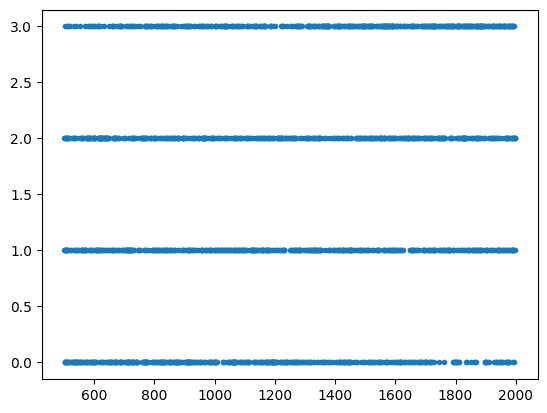

In [28]:
plt.scatter(x['battery_power'],y,marker=".")

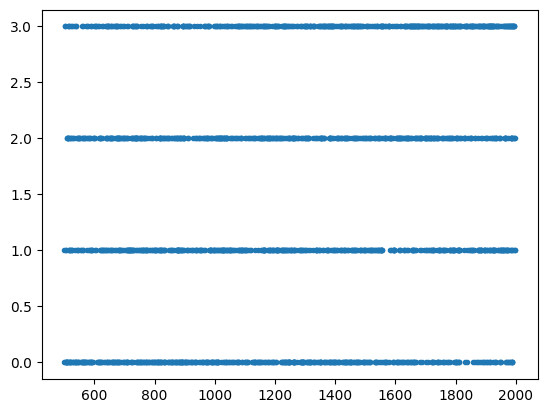

In [29]:
plt.scatter(x['px_width'],y,marker=".")

In [38]:
data0 = data[data.price_range==0]
data1 = data[data.price_range==1]
data2 = data[data.price_range==2]
data3 = data[data.price_range==3]

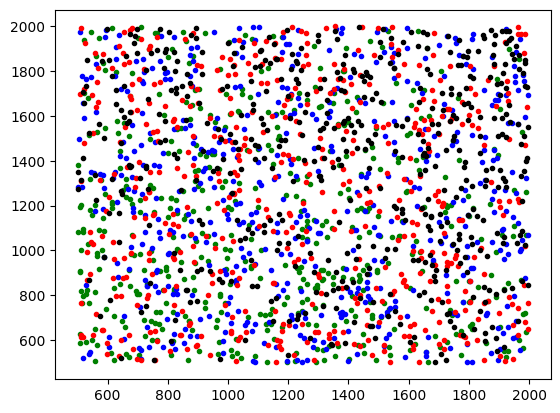

In [41]:
plt.scatter(data0['px_width'],data0['battery_power'],marker=".",color="green")
plt.scatter(data1['px_width'],data1['battery_power'],marker=".",color="blue")
plt.scatter(data2['px_width'],data2['battery_power'],marker=".",color="red")
plt.scatter(data3['px_width'],data3['battery_power'],marker=".",color="black")

In [42]:
from sklearn.model_selection import train_test_split

In [43]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.2,random_state=1)

In [44]:
from sklearn.neighbors import KNeighborsClassifier

In [72]:
knn = KNeighborsClassifier(n_neighbors=10)

In [73]:
knn.fit(x_train,y_train)

KNeighborsClassifier(n_neighbors=10)

In [74]:
print("The probability of getting correct value is: ",knn.score(x_test,y_test))

0.92

In [75]:
from sklearn.metrics import confusion_matrix
y_pred = knn.predict(x_test)
cm = confusion_matrix(y_test,y_pred)
cm

array([[90,  2,  0,  0],
       [ 3, 92,  1,  0],
       [ 0,  9, 95,  2],
       [ 0,  0, 15, 91]], dtype=int64)

Text(58.222222222222214, 0.5, 'Truth')

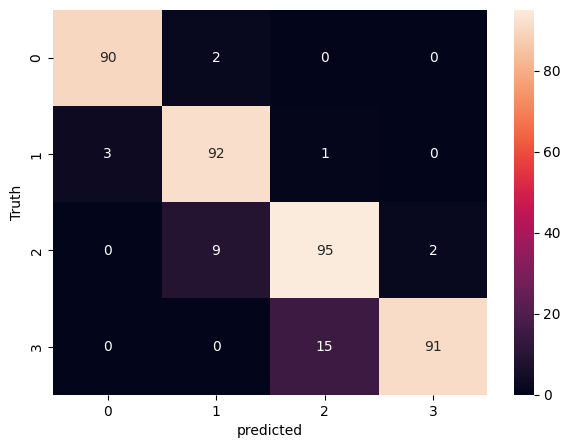

In [76]:
import matplotlib.pyplot as plt
import seaborn as sn
plt.figure(figsize=(7,5))
sn.heatmap(cm, annot=True)  
plt.xlabel('predicted')
plt.ylabel('Truth')

In [89]:
exp_data = pd.read_csv("check.csv")

In [90]:
new_exp = exp_data.to_numpy()

In [104]:
sample = list(new_exp[343])
sample

[1297.0,
 0.0,
 0.5,
 1.0,
 12.0,
 0.0,
 17.0,
 0.1,
 196.0,
 1.0,
 14.0,
 559.0,
 813.0,
 3652.0,
 19.0,
 4.0,
 12.0,
 0.0,
 1.0,
 1.0]

In [105]:
preds = knn.predict([sample])

c:\Users\anike\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(


In [106]:
preds

array([3], dtype=int64)